#**Assignment Name: Predictive Spatial Analysis**

## **Phase A: Introduction and Project Overview**

### Project Title: **Flood Susceptibility Prediction in New Brunswick**

<u>Background</u>

Flooding represents one of the most significant natural hazards affecting communities worldwide, with the potential to cause widespread damage to infrastructure, ecosystems, and livelihoods. In New Brunswick, a history of flood events, particularly along the Saint John River, underscores the need for advanced predictive analytics to identify areas at risk.

<u>Problem Statement</u>

The overarching question driving this project is: **How can we predict the probability of flooding in specific areas of New Brunswick using historical and geographical data?** This analysis aims to support flood risk management, emergency preparedness, and urban planning efforts in the region.

<u>Objectives</u>

- To develop a flood susceptibility model that leverages historical flood events, topographical data, and land cover information.
- To provide a spatial representation of flood susceptibility that can inform decision-making and mitigation strategies.

<u>Data Overview</u>

For this analysis, we will utilize the following datasets:

- **Historical Flood Events**: Derived from the Floods in Canada – Cartographic Product Collection provided by Natural Resources Canada (NRCan).
- **Digital Elevation Model (DEM)**: To assess the topography and derive features such as slope and aspect.
- **Land Cover Data**: To understand the relationship between various land cover types and flood dynamics.
- **Precipitation Data**: Historical weather data will be used to incorporate the role of precipitation in flood events.

<u>Approach</u>

Our approach integrates Data Science and Geospatial Analysis methods within a Jupyter Notebook or Google Colab environment, following the Knowledge Discovery in Databases (KDD) process model. The project is divided into distinct phases, from data acquisition and preprocessing to model training, evaluation, and the application of predictions on a dynamic map.

<u>Significance</u>

The outcomes of this project have the potential to contribute to the resilience of New Brunswick's communities by enhancing our ability to forecast flood events, thus enabling proactive measures to reduce flood impact.


<b> Installation and Importing Packages</b>

In [1]:
# Install required libraries
!pip install owslib rasterio richdem dask folium geopandas matplotlib seaborn scikit-learn scikit-image

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 221.1/221.1 kB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 34.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 329.4/329.4 kB 16.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for richdem: filename=richdem-0.3.4-cp310-cp310-linux_x86_64.whl size=7844532 sha256=b29478438c8e94aa3c3fefa665d0b669e6665b63498325383e1d9c6d8ef21a39
  Stored in directory: /root/.cache/pip/wheels/01/61/27/5c305116b5cffecf04ed75c40f640e2baf231dae20954e31e0
Successfully built richdem


In [2]:
# General utilities
import os  # Operating system functionality
import sys  # Import sys module for using sys.exit()
import requests  # HTTP requests
import zipfile  # Working with zip files
import numpy as np  # Numerical computations
import shutil  # High-level file operations
import tempfile  # Generating temporary files
import gc  # Garbage Collector interface
import warnings  # Warning control

# To ignore the warnings
warnings.filterwarnings("ignore")

# Data manipulation and analysis
import pandas as pd  # Data manipulation and analysis
import geopandas as gpd  # Working with geospatial data
import dask.dataframe as dd  # Parallel computing with Dask

# Raster data processing
import rasterio  # Working with raster data
from rasterio.merge import merge  # Merging raster datasets
from rasterio.plot import show  # Plotting raster datasets
from rasterio.enums import Resampling  # Resampling methods for raster data

# Digital elevation models
import richdem as rd  # Terrain analysis and DEM processing

# Geospatial data processing
from osgeo import gdal, gdalconst  # Geospatial Data Abstraction Library

# Image processing
from skimage.measure import block_reduce  # Reducing image resolution

# Geometry and spatial analysis
from shapely.geometry import Polygon, Point, box  # Geometric shapes
from shapely.ops import unary_union  # Operations on shapes

# Visualization
import matplotlib.pyplot as plt  # Basic plotting
import matplotlib.patches as mpatches  # Patches for legends in plots
import matplotlib.cm as cm  # For colormap selection
import seaborn as sns  # Advanced statistical data visualization
from PIL import Image  # Image processing
import folium  # Interactive mapping
from folium.plugins import MarkerCluster  # Clustering markers on maps

# Machine learning
from sklearn.ensemble import RandomForestClassifier  # Random forest algorithm
from sklearn.model_selection import train_test_split, GridSearchCV  # Data splitting and parameter tuning
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder  # Feature scaling and encoding
from sklearn.metrics import (accuracy_score, roc_auc_score, confusion_matrix,
                             classification_report, roc_curve, auc)  # Model evaluation

# Web map services
import owslib  # OGC Web Services
from owslib.wms import WebMapService  # Web Map Service interface

# Progress bar utility
import progressbar  # Visual progress bar

# Data download and path handling
import urllib.request
from urllib.request import Request, urlopen # URL handling for data download
from urllib.error import HTTPError, URLError # Handle HTTP error

## **PHASE B: DEPENDENT VARIABLE**

This section details the process of acquiring and preparing the flood event dataset, which constitutes the dependent variable for our study on flood susceptibility in New Brunswick. The dataset's journey from acquisition to readiness for analysis includes several crucial steps, meticulously outlined below:

<u>Data Source and Characteristics</u>

- **Source:** The flood event data is sourced from [Natural Resources Canada (NRCan)](https://www.nrcan.gc.ca/), specifically from their [Open Data portal](https://open.canada.ca/data/en/dataset/08b810c2-7c81-40f1-adb1-c32c8a2c9f50). This repository offers comprehensive geospatial data on historical flood events across Canada.

- **Format:** The data is provided in a GeoDatabase (GDB) format, a rich, spatial database format used for storing geographic information and associated attributes.

- **Description:** The dataset encompasses historical records of flood events, which include various attributes related to each event's geographical location, extent, and impact.

- **Projection:** The data within the GDB is projected in [EPSG:2953](https://epsg.io/2953), which is a standard coordinate reference system for geospatial data.

<u>Steps in Data Preparation</u>

- **Downloading:** The initial step involves downloading the GDB file from the NRCan portal, ensuring we have the most recent and comprehensive data on flood events.

- **Extraction:** Given the data's delivery in a compressed format, we proceed to extract it into a working directory, preparing it for loading and analysis.

- **Loading:** Utilizing the [geopandas library](http://geopandas.org/), the extracted data is then loaded into a GeoDataFrame, a powerful data structure that allows for efficient handling of spatial data within Python.


In [3]:
# Define the URL for the flood data and the path where it will be saved
FLOOD_url = 'https://data.eodms-sgdot.nrcan-rncan.gc.ca/public/EGS/EGS_FGP_Geodatabases/Flood_Inondation/archive_archives/EGS_Flood_Product_Archive.gdb.zip'
zip_path = 'FLOOD_Data.gdb.zip'

# Directory to store and extract flood data
flood_data_dir = "FLOOD_Data"

# Ensure the directory exists
os.makedirs(flood_data_dir, exist_ok=True)

# Download the GeoDatabase (GDB) zip file from NRCan
print(f"Downloading flood data from: {FLOOD_url}")
urllib.request.urlretrieve(FLOOD_url, zip_path)
print("Download complete.")

# Extract the contents of the downloaded zip file into the designated folder
print(f"Extracting files to: {flood_data_dir}")
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(flood_data_dir)

print(f"Files successfully extracted to: {flood_data_dir}")

Download complete.
Extracting files to: FLOOD_Data
Files successfully extracted to: FLOOD_Data


Upon loading the flood data into a GeoDataFrame, our focus shifts towards preprocessing this data to align with our study's geographic scope and analytical needs.

<u>Preprocessing Steps</u>

- **Filtering by Region:** To hone in on our area of interest, New Brunswick, we filter the dataset to include only those flood events within this jurisdiction, identified by the 'subdivision_code_client' attribute.

- **Adding a Flood Indicator:** Recognizing the need to explicitly mark flood occurrences, we introduce a binary 'flood' column, serving as our dependent variable in the subsequent modeling process.

- **Projection Transformation:** Acknowledging the importance of accurate spatial representation, we transform the dataset's Coordinate Reference System (CRS) to [EPSG:2953](https://epsg.io/2953). This projection is specifically tailored for New Brunswick, ensuring our spatial analyses remain precise and relevant.

- **Column Selection:** Streamlining the dataset for our analytical focus, we select only the essential attributes: the newly added 'flood' indicator and the geographical information (geometry).


<u>Format Conversion and Saving</u>

To enhance accessibility and facilitate future analyses, the processed dataset is saved in [GeoJSON format](https://geojson.org/), a widely supported format that seamlessly integrates with GIS applications and web mapping tools. This step marks the culmination of our data preparation phase, rendering the dataset primed for in-depth analysis and modeling.


In [4]:
# Define the base path for flood data based on the previously used directory
flood_data_dir = "FLOOD_Data"

# Set the path to the extracted GeoDatabase (GDB) within the flood data directory
gdb_path = os.path.join(flood_data_dir, 'EGS_Flood_Product_Archive.gdb')

# Load the GeoDataFrame from the GDB file
FLOOD_data = gpd.read_file(gdb_path)

# Filter the data for New Brunswick (NB) and indicate flood events with a 'flood' column
FLOOD_DATA_NB = FLOOD_data[FLOOD_data['subdivision_code_client'] == 'NB']
FLOOD_DATA_NB['flood'] = 1  # Add a binary 'flood' indicator column

# Select relevant columns and convert the Coordinate Reference System (CRS) to EPSG:2953 for New Brunswick
FLOOD_DATA_NB = FLOOD_DATA_NB[['flood', 'geometry']].to_crs(epsg=2953)

# Display the filtered and processed DataFrame
FLOOD_DATA_NB.head()

,flood,geometry
0,1,MULTIPOLYGON Z (((2498072.311 7404147.634 0.00...
1,1,MULTIPOLYGON Z (((2531762.984 7392788.411 0.00...
2,1,MULTIPOLYGON Z (((2546381.659 7384263.234 0.00...
3,1,MULTIPOLYGON Z (((2529343.348 7357409.334 0.00...
4,1,MULTIPOLYGON Z (((2546247.516 7354997.163 0.00...


In [5]:
# Display the projection (CRS) of Data
FLOOD_DATA_NB.crs

<Projected CRS: EPSG:2953>
Name: NAD83(CSRS) / New Brunswick Stereographic
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Canada - New Brunswick.
- bounds: (-69.05, 44.56, -63.7, 48.07)
Coordinate Operation:
- name: New Brunswick Stereographic (NAD83)
- method: Oblique Stereographic
Datum: NAD83 Canadian Spatial Reference System
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

<u>Saving and Summarizing the Processed Data</u>

The final step in the data preparation phase is to save our processed GeoDataFrame into a GeoJSON file. This format is chosen for its compatibility with various GIS and web mapping applications, allowing for easier sharing and visualization of the flood event data. The GeoJSON file will contain all necessary information for New Brunswick's flood events, ready to be utilized in further analyses.


In [6]:
# Save the processed data as GeoJSON for easy access and visualization in GIS applications
FLOOD_DATA_NB.to_file('FLOOD_Data/FLOOD_NB.geojson', driver='GeoJSON')

print("Processed GeoDataFrame saved as GeoJSON.")

Processed GeoDataFrame saved as GeoJSON.


<u>Conclusion of Data Processing</u>

With the flood data for New Brunswick downloaded, extracted, filtered, and saved, we have completed the initial data handling phase of our project. This prepared dataset not only marks flood events within the region but also is ready for spatial analysis in predicting flood susceptibility. The next steps will involve exploring this data further, performing analyses, and applying predictive modeling techniques to achieve our project objectives.


## **PHASE C: INDEPENDENT VARIABLES**

Phase C is pivotal in preparing our dataset for flood susceptibility analysis through a series of methodical and strategic steps. Each step is carefully designed to enhance the dataset's quality and relevance for predictive modeling.

#### C.1. DEM Data Processing
Focused on preparing Digital Elevation Model (DEM) data, which included normalizing elevation, slope, and aspect features crucial for understanding the terrain's impact on flood susceptibility.

#### C.2. Precipitation Data Processing
Integrated historical precipitation data to capture weather patterns and their contributions to flood risks, vital for assessing temporal aspects of flood events.

#### C.3. Land Cover Data Processing
Analyzed and processed land cover data to discern the role of various land cover types in flood dynamics, enriching the dataset with environmental context.

#### C.4. Extracting Non-Flood Data
Delineated non-flood areas within the study region to complement flood occurrence data, ensuring a balanced perspective on flood susceptibility across different terrains and conditions.

#### C.5. Visualizing Flood and Non-Flood Data
Employed visualization techniques, notably through plots, to juxtapose flood and non-flood areas, offering intuitive insights into spatial patterns of flood risk.

#### C.6. Data Synthesis
Conducted spatial joins in chunks to efficiently merge DEM, precipitation, and land cover data with flood status information, crafting a comprehensive dataset ready for in-depth analysis.

#### C.7. Data Preprocessing
Applied normalization to numerical features and one-hot encoding to categorical variables, optimizing the dataset for machine learning algorithms. Employed Dask for handling large datasets effectively and preserved geometric data for spatial analysis.

### **C.1. DEM Data Processing**

This segment covers the preprocessing of independent variables related to Digital Elevation Models (DEM). The DEM data will be sourced, merged, reprojected, and analyzed to produce slope and aspect rasters. This information is crucial for understanding the topography and potential water flow, which are key factors in flood susceptibility modeling.

<u>Source</u>

The Digital Elevation Model (DEM) data was obtained from [GeoNB](http://www.snb.ca/geonb1/e/DC/catalogue-E.asp), the Province of New Brunswick's gateway to geographic information and related value-added applications. Specifically, the tiles were downloaded from the New Brunswick Geo Data portal, which provides open access to geographic data.

<u>Why it Was Selected</u>?

The DEM is a foundational element for flood susceptibility analysis as it provides a 3D representation of the terrain surface. Elevation is a critical factor in understanding water flow and accumulation, which are directly related to flood dynamics. The DEM allows for the computation of additional derivatives like slope and aspect, which also influence hydrological and flood-related processes. Furthermore, the provincial source ensures local accuracy and relevance, which is crucial for modeling environmental events within New Brunswick.

<u>Download and Prepare DEM Files</u>

The code below attempts to download DEM tiles from specified URLs.

In [7]:
# Function to download a file with specified user-agent
def download_file_with_urllib(url, filename):
    # Define the user-agent
    user_agent = 'Mozilla/5.0 (Windows NT 10.0; Win64; x64)'
    headers = {'User-Agent': user_agent}

    # Create a request with the URL and custom headers
    request = urllib.request.Request(url, None, headers)

    # Try to download the file, and handle exceptions
    try:
        response = urllib.request.urlopen(request)
        data = response.read()
        with open(filename, 'wb') as file:
            file.write(data)
        print(f"File downloaded successfully: {filename}")
        return True
    except urllib.error.HTTPError as e:
        print(f"HTTP Error: {e.code} {e.reason}")
        if e.code == 403:
            print(f"Encountered a 403 error while attempting to download {filename}.")
        return False
    except urllib.error.URLError as e:
        print(f"URL Error: {e.reason}")
        return False

# Make sure the directory for storing DEM data exists
os.makedirs("DEM_Data", exist_ok=True)

<b>Downloading DEM Tiles</b>

This section of the notebook attempts to automatically download the specified DEM tiles. Should there be any restrictions that lead to a 403 error or similar, the code will look for the presence of these files that have been manually uploaded.

<u>Manual Upload Instructions</u>

In the event that automatic downloading encounters issues (e.g., 403 Forbidden error), you are required to manually upload the necessary DEM files. These files should be uploaded to the `DEM_Data` directory, which the notebook will create if it does not already exist. The specific files required are:

- `nb_2015_16_18_dem_2500000_7430000.tif`
- `nb_2018_dem_2490000_7420000.tif`

To manually upload files:
- **For Google Colab:** Use the file uploader in the left sidebar by clicking on the folder icon, navigating to the `DEM_Data` directory, and using the upload button.
- **For Jupyter Notebook (Local Environment):** Place the files directly into the `DEM_Data` directory within the notebook's current working directory on your system.

After uploading the files to the correct directory, ensure to re-run the notebook cells related to DEM file processing to incorporate these manually uploaded files into your analysis. This process guarantees that your analysis progresses smoothly, regardless of the initial automatic download's success.


In [8]:
# Define a directory to store DEM data
dem_data_dir = "DEM_Data"
os.makedirs(dem_data_dir, exist_ok=True)

# URLs for the DEM data and corresponding filenames
DEM_urls_and_filenames = [
    ('https://geonb.snb.ca/downloads2/elevation/2018/dem/aoi1/nb_2018_dem_2490000_7420000.tif', "nb_2018_dem_2490000_7420000.tif"),
    ('https://geonb.snb.ca/downloads2/elevation/2015_16_18/dem/geotiff/nb_2015_16_18_dem_2500000_7430000.tif', "nb_2015_16_18_dem_2500000_7430000.tif")
]

missing_files_info = []

for url, filename in DEM_urls_and_filenames:
    filepath = os.path.join(dem_data_dir, filename)
    # Check if the file already exists before attempting to download
    if os.path.exists(filepath):
        print(f"\n{filename} is already present in '{dem_data_dir}' directory and will be used for further processing.")
    else:
        try:
            print(f"\nAttempting to download {filename} from {url}")
            opener = urllib.request.build_opener()
            opener.addheaders = [('User-Agent', 'Mozilla/5.0')]
            urllib.request.install_opener(opener)
            urllib.request.urlretrieve(url, filepath)
            print(f"File {filename} downloaded successfully.")
        except (HTTPError, URLError) as e:
            print(f"Failed to download. Error: {e}")
            missing_files_info.append((filename, url))

# If there are missing files after attempt, prompt for manual upload and halt execution
if missing_files_info:
    print("\nPlease manually download these files from the URLs provided above and upload them to the '{}' directory.".format(dem_data_dir))
    print("After uploading, re-run this notebook.\n")
    sys.exit("Halting execution due to missing DEM files.")

print("\nBoth the DEM files are available for processing.")


Attempting to download nb_2018_dem_2490000_7420000.tif from https://geonb.snb.ca/downloads2/elevation/2018/dem/aoi1/nb_2018_dem_2490000_7420000.tif
File nb_2018_dem_2490000_7420000.tif downloaded successfully.

Attempting to download nb_2015_16_18_dem_2500000_7430000.tif from https://geonb.snb.ca/downloads2/elevation/2015_16_18/dem/geotiff/nb_2015_16_18_dem_2500000_7430000.tif
File nb_2015_16_18_dem_2500000_7430000.tif downloaded successfully.

Both the DEM files are available for processing.


<b>Merging, Reprojecting, and Calculating Slope and Aspect</b>

With the necessary DEM tiles available, the next steps are to merge them into a cohesive raster, reproject the result to the New Brunswick-specific projection (EPSG:2953), and then calculate the slope and aspect from the reprojected DEM. These geospatial transformations are required to align the data with our analysis's spatial context.


nb_2018_dem_2490000_7420000.tif file is found and will be used for further processing.
nb_2015_16_18_dem_2500000_7430000.tif file is found and will be used for further processing.

Merging DEM files...
Merged DEM saved at: DEM_Data/merged_dem.tif 

Reprojecting and compressing the merged DEM...
Reprojected and compressed DEM saved at: DEM_Data/reprojected_compressed_dem.tif 

Calculating slope and aspect...
Slope and aspect calculation completed. 

Displaying reprojected and compressed DEM:


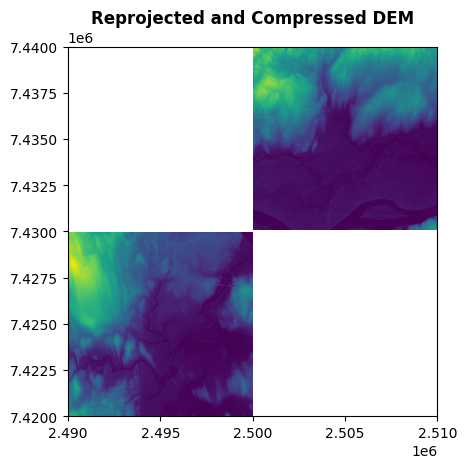

In [9]:
# Define the directory to store DEM data
dem_data_dir = "DEM_Data"
os.makedirs(dem_data_dir, exist_ok=True)

# File names of the DEM files
DEM_filenames = [
    "nb_2018_dem_2490000_7420000.tif",
    "nb_2015_16_18_dem_2500000_7430000.tif"
]

# Check the existence of DEM files
files_exist = []
for filename in DEM_filenames:
    filepath = os.path.join(dem_data_dir, filename)
    if os.path.exists(filepath):
        print(f"{filename} file is found and will be used for further processing.")
        files_exist.append(filepath)
    else:
        print(f"{filename} was not found in '{dem_data_dir}'. Please ensure it is downloaded or uploaded.")

# Halt execution if no DEM files are found
if not files_exist:
    print("\nRequired DEM files are missing. Please ensure all required files are present in 'DEM_Data' directory and try again.")
    sys.exit("Halting execution due to missing DEM files.")

# Proceed with merging the DEM files that exist
print("\nMerging DEM files...")
merged_dem_path = os.path.join(dem_data_dir, "merged_dem.tif")

# Use the list `files_exist` for merging
if files_exist:
    datasets_to_merge = [rasterio.open(file) for file in files_exist]
    mosaic, out_trans = merge(datasets_to_merge)
    meta = datasets_to_merge[0].meta.copy()
    meta.update({"driver": "GTiff", "height": mosaic.shape[1], "width": mosaic.shape[2], "transform": out_trans})
    with rasterio.open(merged_dem_path, 'w', **meta) as dst:
        dst.write(mosaic)
    for ds in datasets_to_merge:
        ds.close()
    print(f"Merged DEM saved at: {merged_dem_path} \n")
else:
    print("No DEM files available for merging. Please check the files in the 'DEM_Data' directory.")

# Continue with the rest of the code as before...

# Reproject and compress the merged DEM
print("Reprojecting and compressing the merged DEM...")
output_reprojected_dem = os.path.join("DEM_Data", "reprojected_compressed_dem.tif")
gdal.Warp(output_reprojected_dem, merged_dem_path, dstSRS='EPSG:2953', creationOptions=['COMPRESS=DEFLATE'])
print(f"Reprojected and compressed DEM saved at: {output_reprojected_dem} \n")

# Paths for the DEM, slope, and aspect files
dem_path = os.path.join("DEM_Data", "reprojected_compressed_dem.tif")
slope_path = dem_path.replace('.tif', '_slope.tif')
aspect_path = dem_path.replace('.tif', '_aspect.tif')

# Calculate slope and aspect
print("Calculating slope and aspect...")
gdal.DEMProcessing(slope_path, dem_path, 'slope')
gdal.DEMProcessing(aspect_path, dem_path, 'aspect')
print("Slope and aspect calculation completed. \n")

# Displaying merged, reprojected, and compressed DEM
with rasterio.open(output_reprojected_dem) as src:
    print("Displaying reprojected and compressed DEM:")
    show(src, title="Reprojected and Compressed DEM")

<b>Creating the GeoDataFrame</b>

Now that we have the slope and aspect, we can create a GeoDataFrame that contains these values along with the elevation for each cell, enabling easy integration with other geospatial datasets. The [GeoPandas library](http://geopandas.org/) is used for this purpose, which facilitates working with geospatial data in Python.


In [10]:
def read_and_resample(raster_path, factor=128):
    with rasterio.open(raster_path) as src:
        data = src.read(
            out_shape=(
                src.count,
                int(src.height / factor),
                int(src.width / factor)
            ),
            resampling=Resampling.bilinear
        )
        transform = src.transform * src.transform.scale(
            (src.width / data.shape[-1]),
            (src.height / data.shape[-2])
        )
        return data[0], transform, src.crs

# Read and resample DEM, slope, and aspect rasters
print("Resampling rasters...")
elevation, transform, crs = read_and_resample(output_reprojected_dem, factor=128)
slope, _, _ = read_and_resample(slope_path, factor=128)
aspect, _, _ = read_and_resample(aspect_path, factor=128)

# Generate polygons for each cell
print("Generating polygons for each raster cell...")
polygons = [box(transform[2] + transform[0] * col,
                transform[5] + transform[4] * (row + 1),
                transform[2] + transform[0] * (col + 1),
                transform[5] + transform[4] * row)
            for row in range(elevation.shape[0]) for col in range(elevation.shape[1])]

# Create a GeoDataFrame
print("Creating GeoDataFrame...")
gdf = gpd.GeoDataFrame({
    'elevation': elevation.flatten(),
    'slope': slope.flatten(),
    'aspect': aspect.flatten(),
    'geometry': polygons
}, crs=crs.to_string())

# Filter out cells with no data
gdf = gdf.dropna(subset=['elevation', 'slope', 'aspect'])

# Save to a GeoJSON file
output_geojson_path = os.path.join("DEM_Data", "DEM_Derivatives.geojson")
gdf.to_file(output_geojson_path, driver='GeoJSON')
print(f"GeoDataFrame saved to: {output_geojson_path} \n")

# Display the first few rows of the GeoDataFrame
gdf.describe()

Resampling rasters...
Generating polygons for each raster cell...
Creating GeoDataFrame...
GeoDataFrame saved to: DEM_Data/DEM_Derivatives.geojson 



,elevation,slope,aspect
count,2.433600e+04,24336.000000,24336.000000
mean,-inf,-4870.353516,-4781.476562
std,inf,4999.711426,5086.377930
min,-3.402823e+38,-9999.000000,-9999.000000
25%,-3.402823e+38,-9999.000000,-9999.000000
50%,9.062763e-01,0.548250,131.021393
75%,1.160669e+01,3.378257,177.802837
max,7.193607e+01,9.804092,288.418671


<b>Data Cleaning</b>

Before utilizing the GeoDataFrame for analysis, it's essential to clean the data. This involves replacing 'no data' values with NaN (Not a Number) to mark them as missing. The `replace` function from the [Pandas library](https://pandas.pydata.org/) is utilized for this operation.


In [11]:
# Replace 'no data' values with numpy's NaN to mark them as missing
gdf['elevation'].replace(-3.402823e+38, np.nan, inplace=True)  # Typically, -3.402823e+38 is used to denote 'no data' in floating-point rasters
gdf['slope'].replace(-9999.0, np.nan, inplace=True)           # -9999 is a common 'no data' value for integer rasters
gdf['aspect'].replace(-9999.0, np.nan, inplace=True)

# Drop rows that have NaN values in any of the columns 'elevation', 'slope', 'aspect'
gdf.dropna(subset=['elevation', 'slope', 'aspect'], inplace=True)

# Reset the index to ensure a clean, continuous sequence after dropping rows
gdf.reset_index(drop=True, inplace=True)

# Display a summary of the cleaned GeoDataFrame to understand the range and distribution of the data
gdf.describe()

,elevation,slope,aspect
count,12478.000000,12478.000000,12478.000000
mean,16.707800,3.463544,176.801163
std,16.360971,1.337949,21.975628
min,0.756004,0.006395,89.146042
25%,3.143460,2.596444,166.356766
50%,10.590440,3.344179,177.485527
75%,27.516892,4.235884,185.804592
max,71.936066,9.804092,288.418671


In [12]:
# Display the dataframe
gdf.head()

,elevation,slope,aspect,geometry
0,65.858917,4.504070,149.281021,"POLYGON ((2499999.500 7439871.795, 2499999.500..."
1,64.836906,3.319330,152.995621,"POLYGON ((2500127.712 7439871.795, 2500127.712..."
2,63.889915,4.663961,159.569870,"POLYGON ((2500255.923 7439871.795, 2500255.923..."
3,58.201477,5.884993,110.816536,"POLYGON ((2500384.135 7439871.795, 2500384.135..."
4,51.973286,4.211946,157.027802,"POLYGON ((2500512.346 7439871.795, 2500512.346..."


### **C.2. Precipitation Data Processing**

In this section, we access and process precipitation data, which is a crucial independent variable for flood susceptibility analysis. The data is retrieved via an API, clipped to the study area's bounds determined by the DEM processing step, and prepped for integration into the flood susceptibility model.

<u>Source</u>

The precipitation data was accessed through the [Meteorological Service of Canada's API](https://eccc-msc.github.io/open-data/msc-geomet/readme_en/), which offers historical climate data. This data is provided in GeoJSON format, allowing for seamless integration with our geospatial analysis.

<u>Why It Was Selected</u>?

Precipitation is a direct input to the hydrological cycle and can significantly influence the occurrence and severity of floods. It is particularly important to understand historical precipitation patterns and extreme weather events that have previously led to flooding. By incorporating this data, we can improve our model's ability to predict flood susceptibility under varying climatic conditions. The choice of this data source is motivated by its comprehensive coverage, high resolution, and the authoritative nature of the Meteorological Service of Canada.


In [13]:
# API endpoint and parameters for fetching precipitation data
url = "https://api.weather.gc.ca/collections/ltce-precipitation/items"
params = {
    "f": "json",
    "lang": "en-CA",
    "limit": 10000,
    "PROVINCE_CODE": "NB"
}
headers = {"Accept": "application/geo+json"}

# Make the API request to obtain precipitation data
response = requests.get(url, params=params, headers=headers)
data = response.json()

# Load the features from the response into a GeoDataFrame and set the coordinate system
gdf_precip = gpd.GeoDataFrame.from_features(data["features"], crs="EPSG:4326")

# Transform CRS to match that used in DEM processing (EPSG:2953)
gdf_precip = gdf_precip.to_crs(epsg=2953)

<b>Clipping and Buffering Precipitation Data</b>

After retrieving the precipitation data, it's clipped to our study area, derived from the DEM analysis. We apply a 2000-meter buffer around each data point to account for the spatial extent of precipitation influence. The choice of a 2000-meter buffer is a compromise between capturing the area significantly affected by each precipitation event and maintaining computational efficiency. This distance considers the typical scale of precipitation impact in relation to the spatial resolution of our other datasets, ensuring our model accurately reflects the influence of precipitation on flood susceptibility.



In [14]:
# Calculate the bounds of the DEM GeoDataFrame
bounds = gdf.total_bounds
xmin, ymin, xmax, ymax = bounds

# Clip precipitation data to the area of interest defined by the DEM bounding box
gdf_precip_clipped = gdf_precip.cx[xmin:xmax, ymin:ymax]

# Apply a buffer to account for the area of influence around each precipitation point
gdf_precip_clipped["geometry"] = gdf_precip_clipped.geometry.buffer(2000)

<b>Cleaning and Saving Processed Precipitation Data</b>

We finalize the preprocessing of precipitation data by selecting relevant columns, addressing missing values, and saving the cleaned dataset. The cleaned GeoDataFrame will be ready for use in further analysis or integration with other datasets.


In [15]:
# Select relevant columns for the analysis
cols_to_keep = [
    'geometry',
    'RECORD_PRECIPITATION',
    'PREV_RECORD_PRECIPITATION'
]
PRECIPITATION_NB_final = gdf_precip_clipped[cols_to_keep].copy()

# Check for missing values in the data
missing_values = PRECIPITATION_NB_final.isna().sum()
print("Missing values before cleaning:", missing_values)

# Fill missing values for 'PREV_RECORD_PRECIPITATION' with the median value
prev_record_precip_median = PRECIPITATION_NB_final['PREV_RECORD_PRECIPITATION'].median()
PRECIPITATION_NB_final['PREV_RECORD_PRECIPITATION'].fillna(prev_record_precip_median, inplace=True)

# Drop any remaining rows with missing data
PRECIPITATION_NB_final.dropna(inplace=True)

# Reset index after dropping rows
PRECIPITATION_NB_final.reset_index(drop=True, inplace=True)

# Check for missing values in the data after cleaning
missing_values = PRECIPITATION_NB_final.isna().sum()
print("\nMissing values after cleaning:", missing_values)

# Save the cleaned GeoDataFrame as a GeoJSON for future use
processed_file_path = 'PRECIPITATION_NB_Processed_Cleaned.geojson'
PRECIPITATION_NB_final.to_file(processed_file_path, driver='GeoJSON')
print(f"\nProcessed precipitation data saved to: {processed_file_path}\n ")

# Display the dataframe
PRECIPITATION_NB_final.head()

Missing values before cleaning: geometry                     0
RECORD_PRECIPITATION         0
PREV_RECORD_PRECIPITATION    4
dtype: int64

Missing values after cleaning: geometry                     0
RECORD_PRECIPITATION         0
PREV_RECORD_PRECIPITATION    0
dtype: int64

Processed precipitation data saved to: PRECIPITATION_NB_Processed_Cleaned.geojson
 


,geometry,RECORD_PRECIPITATION,PREV_RECORD_PRECIPITATION
0,"POLYGON ((2503553.568 7426642.735, 2503543.938...",49.3,4.1
1,"POLYGON ((2503553.568 7426642.735, 2503543.938...",43.7,41.0
2,"POLYGON ((2503553.568 7426642.735, 2503543.938...",74.1,44.7
3,"POLYGON ((2503553.568 7426642.735, 2503543.938...",77.2,54.1
4,"POLYGON ((2503553.568 7426642.735, 2503543.938...",34.5,21.8


### **C.3. Land Cover Data Processing**

Land cover is an influential independent variable in flood susceptibility studies. Different types of land cover influence the hydrological processes differently—some facilitate infiltration, while others can lead to increased runoff. In this section, we outline the acquisition and preparation of the land cover dataset for New Brunswick, detailing our data source and the reasons behind its selection.

<u>Source</u>

The land cover dataset is sourced from [Agriculture and Agri-Food Canada](https://agriculture.canada.ca/atlas/data_donnees/nationalEcologicalFramework/data_donnees/geoJSON/er/nef_ecoreg_landcover.geojson), which provides geospatial data at the national level. This dataset is part of the National Ecological Framework, which offers land cover data in a GeoJSON format for ease of use in GIS applications.

<u>Why it was Selected</u>?

The selection of this particular land cover dataset is motivated by its national scope and high level of detail, which is ideal for ecological and environmental modeling. The data classification includes various land cover types that are essential for distinguishing between areas that are likely to absorb precipitation and those that could contribute to surface runoff and potential flooding.


In [16]:
# Download the land cover data from Agriculture and Agri-Food Canada
admin_zones_url = 'https://agriculture.canada.ca/atlas/data_donnees/nationalEcologicalFramework/data_donnees/geoJSON/er/nef_ecoreg_landcover.geojson'
land_cover_file_path = 'nef_ecoreg_landcover.geojson'

# Download the file and save it locally
urllib.request.urlretrieve(admin_zones_url, land_cover_file_path)
print(f"Land cover data downloaded and saved as {land_cover_file_path}.")

Land cover data downloaded and saved as nef_ecoreg_landcover.geojson.


<b>Loading and Transforming Land Cover Data</b>

Upon downloading the land cover dataset, we read the data into a GeoDataFrame and transform the coordinate reference system to match our study area's CRS. The dataset's CRS and data structure are checked to confirm successful loading and CRS transformation.


In [17]:
# Read the downloaded GeoJSON file into a GeoDataFrame
data_landcover = gpd.read_file(land_cover_file_path)

# Display the original CRS
print("Original CRS:", data_landcover.crs)

# Transform the CRS to match the study area's CRS (EPSG:2953)
data_landcover = data_landcover.to_crs(epsg=2953)
print("\nTransformed to CRS EPSG:2953 \n")

# Dsiplay the data structure
data_landcover.info()

Original CRS: EPSG:4326

Transformed to CRS EPSG:2953 

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 761 entries, 0 to 760
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype   
---  ------             --------------  -----   
 0   OBJECTID_1         761 non-null    int64   
 1   OBJECTID           761 non-null    int64   
 2   COMPONENT_NUM      761 non-null    int64   
 3   LANDCOVER_PERCENT  761 non-null    int64   
 4   ECOREGION_ID       761 non-null    int64   
 5   LANDCOVER_CODE     761 non-null    int64   
 6   DESCRIPTION_EN     761 non-null    object  
 7   DESCRIPTION_FR     761 non-null    object  
 8   SHAPE_Length       761 non-null    float64 
 9   SHAPE_Area         761 non-null    float64 
 10  geometry           761 non-null    geometry
dtypes: float64(2), geometry(1), int64(6), object(2)
memory usage: 65.5+ KB


<b>Clipping Land Cover Data to Study Area</b>

The land cover data is clipped to the study area defined by the bounding box coordinates derived from the DEM processing step. This ensures that the land cover data corresponds exactly to our area of interest for flood susceptibility modeling.


In [18]:
# Calculate the bounds of the DEM GeoDataFrame
bounds = gdf.total_bounds
xmin, ymin, xmax, ymax = bounds

# Create a bounding box geometry from the coordinates
study_area_box = box(xmin, ymin, xmax, ymax)

# Clip the land cover data to the study area
data_landcover_clipped = gpd.clip(data_landcover, study_area_box)
print("Land cover data clipped to the study area.")

Land cover data clipped to the study area.


<b>Selecting Relevant Data and Saving Processed Land Cover</b>

With the clipped land cover data, we select only the essential columns required for our analysis. This includes percentage cover, land cover code, and descriptions. The final processed GeoDataFrame is then saved as a GeoJSON file, ready for integration with other datasets.


In [19]:
# Select the columns needed for further analysis
cols_to_keep = ['LANDCOVER_PERCENT', 'LANDCOVER_CODE', 'DESCRIPTION_EN', 'geometry']
data_landcover_clipped = data_landcover_clipped[cols_to_keep]

# Save the processed land cover data to a GeoJSON file for subsequent analysis
output_filename = 'LANDCOVER_NB_Processed.geojson'
data_landcover_clipped.to_file(output_filename, driver='GeoJSON')
print(f"Processed land cover data saved to: {output_filename}. \n")

# Display the first few rows to verify the processed GeoDataFrame
data_landcover_clipped.head()

Processed land cover data saved to: LANDCOVER_NB_Processed.geojson. 



,LANDCOVER_PERCENT,LANDCOVER_CODE,DESCRIPTION_EN,geometry
583,5,9,Cropland: cultivated land,"POLYGON ((2489999.000 7420000.000, 2489999.000..."
585,53,1,Mixed Forest: canopy 26-75% coniferous/broadle...,"POLYGON ((2489999.000 7420000.000, 2489999.000..."
587,7,2,Broadleaf Forest: canopy >75% broadleaf trees,"POLYGON ((2489999.000 7420000.000, 2489999.000..."
586,32,5,Coniferous Forest: canopy >75% coniferous trees,"POLYGON ((2489999.000 7420000.000, 2489999.000..."
584,3,7,Sparsely Vegetated/Barren Land: plant cover ge...,"POLYGON ((2489999.000 7420000.000, 2489999.000..."


<b>Conclusion of Land Cover Data Processing</b>

The processing of the land cover data concludes with a prepared dataset that aligns with the needs of our flood susceptibility analysis. This dataset will provide valuable insights into how different land cover types may affect flooding potential in New Brunswick.

### **C.4. Extracting Non-Flood Data**

To complement our flood susceptibility analysis, it's essential to include areas not affected by flooding alongside those that are. This step involves defining non-flood areas within the study region based on the existing flood data. By delineating non-flood areas, we can enhance our model's ability to differentiate between flood-prone and safe zones, improving its predictive accuracy.

<u>Objectives</u>:

- Utilize the bounding box from the DEM processing to define the study area.
- Extract non-flood areas by differentiating between the study area and locations of known flood events.
- Create a GeoDataFrame representing non-flood areas for further analysis.


In [20]:
# Calculate the bounds of the DEM GeoDataFrame
bounds = gdf.total_bounds
xmin, ymin, xmax, ymax = bounds

# Define the study area using the bounding box and create a GeoDataFrame for it
study_area_box = box(xmin, ymin, xmax, ymax)
study_area_gdf = gpd.GeoDataFrame(geometry=[study_area_box], crs='EPSG:2953')

# Simplify and ensure the validity of the flood data geometries to handle complex datasets
simplify_tolerance = 0.01
FLOOD_DATA_NB['geometry'] = FLOOD_DATA_NB.geometry.simplify(tolerance=simplify_tolerance, preserve_topology=True).buffer(0)

# Clip flood data to the study area to ensure consistency
FLOOD_DATA_NB_clipped = gpd.clip(FLOOD_DATA_NB, study_area_gdf)

# Create non-flood areas by subtracting flood areas from the study area
union_flood = unary_union(FLOOD_DATA_NB_clipped.geometry)
non_flood_geometry = study_area_box.difference(union_flood)

# Initialize a GeoDataFrame for non-flood areas and set 'flood' column to 0
non_flood_data = gpd.GeoDataFrame(geometry=[non_flood_geometry], crs='EPSG:2953')
non_flood_data['flood'] = 0  # Indicates these areas are not flooded

# Save the non-flood data to a GeoJSON file
non_flood_data.to_file('FLOOD_Data/NON_FLOOD_NB.geojson', driver='GeoJSON')

# Display the first few rows of the non-flood data for verification
non_flood_data.head()

,geometry,flood
0,MULTIPOLYGON Z (((2510000.000 7420000.000 0.00...,0


### **C.5. Visualizing Flood and Non-Flood Data**

Visualization is a powerful tool for understanding the spatial distribution of flood susceptibility. In this section, we create a plot that overlays flood and non-flood areas within the study region. This helps to illustrate the model's capability to distinguish between areas that have historically experienced flooding and those that have not. Such visualizations are not only essential for analysis but also for communicating the results to stakeholders and decision-makers.



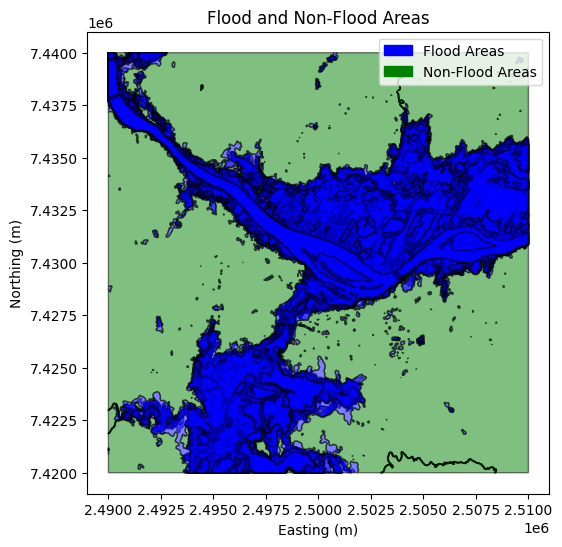

In [21]:
# Create figure and axes
fig, ax = plt.subplots(figsize=(6, 6))

# Plot flood areas
FLOOD_DATA_NB_clipped.plot(ax=ax, color='blue', edgecolor='k', alpha=0.5)

# Plot non-flood areas
non_flood_data.plot(ax=ax, color='green', edgecolor='k', alpha=0.5)

# Create a legend
flood_patch = mpatches.Patch(color='blue', label='Flood Areas')
non_flood_patch = mpatches.Patch(color='green', label='Non-Flood Areas')
plt.legend(handles=[flood_patch, non_flood_patch])

# Set plot title and labels
plt.title('Flood and Non-Flood Areas')
plt.xlabel('Easting (m)')
plt.ylabel('Northing (m)')

# Show the plot
plt.show()

<b>Discussion of Visual Results</b>

The provided visualization offers a clear distinction between flood-prone areas (blue) and non-flood zones (green). This distinction is vital for understanding the spatial patterns of flood susceptibility within the study area.

<u>Key Observations</u>:
- **Flood Areas**: The flood zones predominantly align along what appears to be the riverine network, which is consistent with expected flood behavior. These areas are likely low-lying and adjacent to water bodies, making them susceptible to flooding during heavy rainfall or snowmelt.
  
- **Non-Flood Areas**: The larger green patches represent areas that have not been historically affected by flooding. These regions may have natural barriers, such as higher elevation or dense vegetation, that reduce their flood risk.

<u>Implications for Flood Susceptibility Analysis</u>:

- **Model Training**: The distinct patterns observed between flood and non-flood areas will aid in training a predictive model. The model can learn the characteristics of each type of area to better predict flood susceptibility.

- **Risk Management**: For stakeholders and decision-makers, this map underscores the regions where flood mitigation strategies and infrastructure should be focused to reduce potential damages.

- **Community Planning**: The visualization can be used for urban planning, ensuring new developments avoid high-risk flood areas, and reinforcing existing structures in vulnerable zones.



### **C.6. Data Synthesis**

After preparing the independent variables (DEM, Precipitation, Land Cover) and delineating flood and non-flood areas, the next crucial step is to synthesize this information into a comprehensive dataset. This synthesized dataset will combine the characteristics of the land (e.g., elevation, precipitation rates, land cover type) with flood occurrence data, enabling us to conduct a detailed flood susceptibility analysis.

<u>Objectives</u>:

- Integrate flood and non-flood data with the attributes from DEM, Precipitation, and Land Cover datasets.
- Address data compatibility issues, ensuring a uniform spatial reference system across all datasets.
- Handle missing values judiciously to maintain data integrity.
- Analyze correlations among variables to identify significant predictors for flood susceptibility.


In [22]:
# Define paths for the datasets
paths = {
    "dem": 'DEM_Data/DEM_Derivatives.geojson',
    "land_cover": 'LANDCOVER_NB_Processed.geojson',
    "precipitation": 'PRECIPITATION_NB_Processed_Cleaned.geojson',
    "flood": 'FLOOD_Data/FLOOD_NB.geojson',
    "non_flood": 'FLOOD_Data/NON_FLOOD_NB.geojson'
}

# Calculate the bounds of the DEM GeoDataFrame
bounds = gdf.total_bounds
xmin, ymin, xmax, ymax = bounds

# Define the study area using the bounding box
study_area_bbox = box(xmin, ymin, xmax, ymax)

In [23]:
# Function to load, clip, and preprocess GeoDataFrames with simplification
def load_and_preprocess_gdf(file_path, bbox, crs_epsg=2953, tolerance=0.05):
    gdf = gpd.read_file(file_path).to_crs(epsg=crs_epsg)
    clipped_gdf = gpd.clip(gdf, bbox)
    if tolerance > 0:
        clipped_gdf['geometry'] = clipped_gdf.geometry.simplify(tolerance=tolerance, preserve_topology=True)
    valid_gdf = clipped_gdf.loc[clipped_gdf.geometry.is_valid]
    return valid_gdf

# Loading and preprocessing all datasets
datasets = {key: load_and_preprocess_gdf(path, study_area_bbox, tolerance=0.05) for key, path in paths.items()}

<b>Combining Flood and Non-Flood Data</b>

To conduct a comprehensive analysis, we combine flood and non-flood data into a single dataset. This integration allows us to understand the environmental characteristics of both flood-prone and safe areas.


In [24]:
# Merge the datasets
flood_status_data = pd.concat([datasets['flood'], datasets['non_flood']], ignore_index=True).drop_duplicates().reset_index(drop=True)

<b>Spatial Join Process in Chunks of the datasets</b>

<u>Process Overview</u>:
1. **Initialization**: A progress bar is set up to monitor the process across the total number of iterations determined by the dataset size and chunk size.
2. **Chunk Processing**: The target data (flood status) is divided into chunks, and a spatial join is performed with the other data (DEM, Land Cover, Precipitation) for each chunk. This step reduces memory usage and speeds up the processing.
3. **Sampling**: After joining, each chunk's results are optionally sampled to reduce the data volume further, ensuring that the process remains manageable and efficient.
4. **Aggregation**: The processed chunks are then aggregated into a combined result, providing a synthesized dataset ready for further analysis.

<u>Implementation Details</u>:
- The `process_in_chunks` function encapsulates this process, taking as input the target data, other data for joining, the chunk size, and the sampling fraction.
- The function is used sequentially to first join the DEM data with flood status, followed by Land Cover, and finally Precipitation data.
- The resulting `combined_data_full` dataset contains a synthesized view of flood and non-flood areas with associated environmental characteristics, prepared for the next steps in the flood susceptibility analysis.


In [25]:
# Function to process in chunks and perform spatial joins using progressbar for visualization
def process_in_chunks(target_data, other_data, chunk_size=100, sample_frac=0.1):
    results = []
    # Calculate the total number of iterations for the progress bar
    total_iterations = (len(target_data) - 1) // chunk_size + 1

    # Initialize the progress bar
    bar = progressbar.ProgressBar(maxval=total_iterations).start()

    for i in range(0, len(target_data), chunk_size):
        chunk = target_data.iloc[i:i+chunk_size]
        joined = gpd.sjoin(chunk, other_data, how='left', op='intersects')
        joined = joined.drop(columns=[col for col in joined.columns if col.startswith('index')]).reset_index(drop=True)
        sampled = joined.sample(frac=sample_frac) if len(joined) > 1/sample_frac else joined
        results.append(sampled)

        # Update the progress bar
        bar.update(i // chunk_size + 1)

    # Finish the progress bar
    bar.finish()

    combined_result = pd.concat(results, ignore_index=True)
    return combined_result

# Join DEM Data first
combined_data_dem = process_in_chunks(flood_status_data, datasets['dem'], chunk_size=500, sample_frac=0.125)

# Join Land Cover Data next
combined_data_landcover = process_in_chunks(combined_data_dem, datasets['land_cover'], chunk_size=500, sample_frac=0.1)

# Join Precipitation Data last
combined_data_full = process_in_chunks(combined_data_landcover, datasets['precipitation'], chunk_size=500, sample_frac=0.1)

100% (1 of 1) |##########################| Elapsed Time: 0:00:06 Time:  0:00:06
100% (50 of 50) |########################| Elapsed Time: 0:01:28 Time:  0:01:28
100% (25 of 25) |########################| Elapsed Time: 0:01:47 Time:  0:01:47


<b>Data Cleaning and Summary Statistics</b>

After synthesizing our dataset through spatial joins, the next crucial step is to assess and clean the data. This involves identifying and handling missing values, correcting any data inconsistencies, and replacing placeholder values with statistically meaningful substitutes. A thorough data cleaning process is fundamental for ensuring the quality and reliability of our flood susceptibility analysis.

<u>Objectives</u>:

- Identify and quantify missing values across all variables in the dataset.
- Replace extreme or placeholder values that could skew the analysis with NaNs to accurately calculate summary statistics.
- Impute missing values using median imputation for numerical variables to preserve data distribution.
- Reassess the dataset for missing values and review summary statistics to ensure data integrity.


In [26]:
# Initial check for statistical summary
print("Initial Check for Statistical summary:")
combined_data_full.describe()

Initial Check for Statistical summary:


,flood,elevation,slope,aspect,LANDCOVER_PERCENT,LANDCOVER_CODE,RECORD_PRECIPITATION,PREV_RECORD_PRECIPITATION
count,362880.000000,3.628800e+05,362880.000000,362880.000000,362880.000000,362880.000000,362880.000000,362880.000000
mean,0.916209,-1.110362e+38,-3260.701287,-3142.892694,19.661321,4.817375,44.681313,27.205753
std,0.277074,1.595453e+38,4689.561937,4771.569192,19.450617,2.987904,17.054457,10.907794
min,0.000000,-3.402823e+38,-9999.000000,-9999.000000,3.000000,1.000000,19.600000,0.000000
25%,1.000000,-3.402823e+38,-9999.000000,-9999.000000,5.000000,2.000000,33.000000,20.600000
50%,1.000000,1.790810e+00,2.245640,173.107971,7.000000,5.000000,41.000000,26.700000
75%,1.000000,3.280185e+00,3.325559,180.225891,32.000000,7.000000,52.400000,33.000000
max,1.000000,6.487960e+01,9.610585,288.418671,53.000000,9.000000,148.600000,65.800000


<b>Handling Placeholder and Extreme Values</b>

Certain variables, such as 'elevation', 'slope', and 'aspect', might contain placeholder or extreme negative values used to denote missing or undefined data. These values need to be addressed to prevent distortion in our analysis.


In [27]:
# Replace extreme negative values with NaN to accurately reflect missing data
combined_data_full.loc[combined_data_full['elevation'] <= -1e38, 'elevation'] = np.nan
combined_data_full.loc[combined_data_full['slope'] <= -9999, 'slope'] = np.nan
combined_data_full.loc[combined_data_full['aspect'] <= -9999, 'aspect'] = np.nan

# Recalculate medians for 'elevation', 'slope', and 'aspect' after replacing extreme values with NaN
elevation_median = combined_data_full['elevation'].median()
slope_median = combined_data_full['slope'].median()
aspect_median = combined_data_full['aspect'].median()

# Impute missing values using the new median values
combined_data_full['elevation'].fillna(elevation_median, inplace=True)
combined_data_full['slope'].fillna(slope_median, inplace=True)
combined_data_full['aspect'].fillna(aspect_median, inplace=True)

# Handling missing values in 'PREV_RECORD_PRECIPITATION' similarly
prev_record_precip_median = combined_data_full['PREV_RECORD_PRECIPITATION'].median()
combined_data_full['PREV_RECORD_PRECIPITATION'].fillna(prev_record_precip_median, inplace=True)

# After cleaning, check for statistical summary to verify the changes
print("Statistical summary after cleaning:")
combined_data_full.describe()

Statistical summary after cleaning:


,flood,elevation,slope,aspect,LANDCOVER_PERCENT,LANDCOVER_CODE,RECORD_PRECIPITATION,PREV_RECORD_PRECIPITATION
count,362880.000000,362880.000000,362880.000000,362880.000000,362880.000000,362880.000000,362880.000000,362880.000000
mean,0.916209,3.747173,3.004212,177.976955,19.661321,4.817375,44.681313,27.205753
std,0.277074,5.589336,1.183240,13.021428,19.450617,2.987904,17.054457,10.907794
min,0.000000,0.756004,0.006395,90.761299,3.000000,1.000000,19.600000,0.000000
25%,1.000000,2.240061,2.588496,175.954681,5.000000,2.000000,33.000000,20.600000
50%,1.000000,2.731160,2.971552,178.157150,7.000000,5.000000,41.000000,26.700000
75%,1.000000,3.280185,3.325559,180.225891,32.000000,7.000000,52.400000,33.000000
max,1.000000,64.879601,9.610585,288.418671,53.000000,9.000000,148.600000,65.800000


<b>Preparing for Correlation Analysis</b>

Before we can build a predictive model for flood susceptibility, it's essential to understand how the different variables in our dataset relate to one another. Correlation analysis is a statistical method used to evaluate the strength and direction of relationships between quantitative variables.

<u>Objectives of the Correlation Analysis</u>:

- **Identify Relationships**: Determine which variables have strong relationships with one another, which can inform feature selection for modeling.
- **Guide Model Development**: Use the insights gained from correlation strengths to develop hypotheses about potential predictive variables for flood occurrence.
- **Address Multicollinearity**: Identify and mitigate issues of multicollinearity, where two or more variables are highly correlated and could distort the model.

We will visualize these relationships using a correlation heatmap. This visualization technique uses color coding to represent the correlation coefficients, making it easier to spot patterns and relationships at a glance.



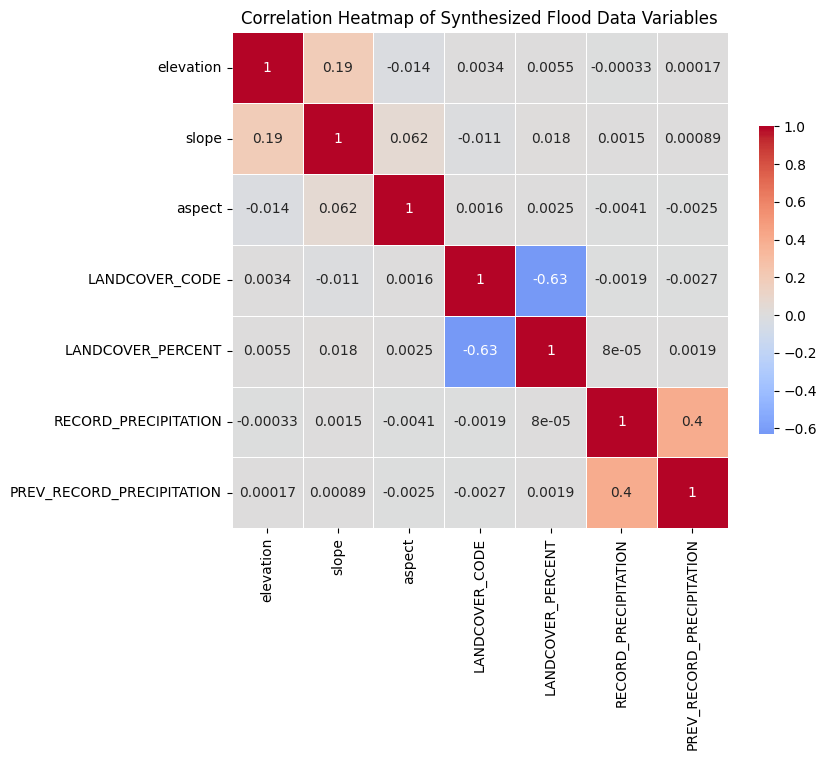

In [28]:
# Compute the correlation matrix for numeric columns
numeric_columns = ['elevation', 'slope', 'aspect', 'LANDCOVER_CODE', 'LANDCOVER_PERCENT', 'RECORD_PRECIPITATION', 'PREV_RECORD_PRECIPITATION']
corr_matrix = combined_data_full[numeric_columns].corr()

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(8, 8))

# Generate a sequential colormap
cmap = sns.color_palette("coolwarm", as_cmap=True)

# Draw the heatmap
sns.heatmap(corr_matrix, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)

plt.title('Correlation Heatmap of Synthesized Flood Data Variables')
plt.show()

<b>Analysis of Correlation Heatmap Results</b>

The correlation heatmap displayed provides a visual representation of the relationships between various environmental factors and their potential influence on flooding events. Key observations from the heatmap are as follows:

<u>Key Observations</u>:

- **Elevation and Slope**: There is a positive correlation between elevation and slope, which is expected as steeper slopes are typically found at higher elevations.
- **Land Cover Percent and Land Cover Code**: The negative correlation here may suggest that as the percentage of a particular land cover type increases, the diversity of land cover codes decreases, indicating more uniform areas.
- **Record Precipitation and Previous Record Precipitation**: Both show moderate positive correlations with each other, which may imply that periods of high precipitation have a historical precedent.

<u>Implications</u>:

- **Predictive Features**: The absence of strong correlations directly with flood occurrences suggests that no single variable is a dominant predictor on its own. This emphasizes the need for a multi-faceted approach in modeling flood susceptibility.
- **Data Insights**: Variables such as slope and land cover characteristics are important, yet their correlations suggest that their relationship with flood occurrence is complex and possibly mediated by other factors.
- **Strategic Planning**: For stakeholders, understanding these relationships can inform strategic planning, such as where to implement flood control measures or conservation efforts based on land cover types.

The insights gained from this correlation analysis will be crucial for selecting the right features for our predictive models and interpreting their outputs. The subtleties in the data underscore the complexity of flood dynamics and highlight the importance of using advanced modeling techniques that can capture interactions between different predictors.


### **C.7. Data Preprocessing**

Data preprocessing is a critical step before moving on to model training. This phase involves preparing our dataset through normalization of numerical features, encoding categorical variables, and efficiently handling large datasets. Our objectives are to ensure that the dataset is in a format conducive to machine learning algorithms, which often require numerical input and benefit from feature scaling.

<u>Objectives</u>:

- Normalize numerical features to ensure they are on the same scale, improving the performance of many machine learning algorithms.
- Convert categorical variables into a format that can be provided to ML algorithms via one-hot encoding.
- Use Dask for efficient computation on large datasets, facilitating operations like removing duplicates.
- Retain geometric data for spatial analysis and ensure the final dataset is compatible with geospatial analysis tools.


In [29]:
# Normalize numerical features
numerical_features = ['elevation', 'slope', 'aspect', 'LANDCOVER_CODE', 'LANDCOVER_PERCENT', 'RECORD_PRECIPITATION', 'PREV_RECORD_PRECIPITATION']

scaler = MinMaxScaler()
combined_data_full[numerical_features] = scaler.fit_transform(combined_data_full[numerical_features])
# Normalization makes our numerical data more consistent and interpretable for models.

# One-Hot Encoding for categorical variables
encoder = OneHotEncoder(sparse=False)
encoded_features = encoder.fit_transform(combined_data_full[['DESCRIPTION_EN']])
encoded_feature_names = encoder.get_feature_names_out(['DESCRIPTION_EN'])
# Encoding transforms categorical data into numerical, enabling its use in ML models.

# Prepare the DataFrame for encoded features and merge
encoded_df = pd.DataFrame(encoded_features, columns=encoded_feature_names)
combined_data_full = combined_data_full.drop(columns=['DESCRIPTION_EN'])
combined_data_full = pd.concat([combined_data_full.reset_index(drop=True), encoded_df.reset_index(drop=True)], axis=1)

# Handling geometric data separately to preserve spatial information
geometry_data = combined_data_full.pop('geometry')

# Utilizing Dask DataFrame for large dataset computation
dask_df = dd.from_pandas(combined_data_full, npartitions=10)
dask_df = dask_df.drop_duplicates().compute()
# Dask helps manage large data by splitting into partitions and parallel processing.

# Reintegrating geometry data into a GeoDataFrame
combined_data_full = gpd.GeoDataFrame(dask_df, geometry=geometry_data)

# Ensure the 'geometry' column is correctly identified
combined_data_full = gpd.GeoDataFrame(combined_data_full, geometry='geometry')

# Checking for duplicate columns and removing them if any
duplicates = {col1: [col2 for col2 in combined_data_full.columns[i + 1:] if combined_data_full[col1].equals(combined_data_full[col2])]
              for i, col1 in enumerate(combined_data_full.columns)}
columns_to_remove = set([item for sublist in duplicates.values() for item in sublist])
combined_data_full = combined_data_full.drop(columns=columns_to_remove)

print("Data preprocessing complete. The dataset is ready for further analysis or modeling. \n")
print(combined_data_full.info())

Data preprocessing complete. The dataset is ready for further analysis or modeling. 

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 243736 entries, 0 to 362879
Data columns (total 14 columns):
 #   Column                                                                     Non-Null Count   Dtype   
---  ------                                                                     --------------   -----   
 0   flood                                                                      243736 non-null  int64   
 1   elevation                                                                  243736 non-null  float64 
 2   slope                                                                      243736 non-null  float64 
 3   aspect                                                                     243736 non-null  float64 
 4   LANDCOVER_PERCENT                                                          243736 non-null  float64 
 5   LANDCOVER_CODE                                  

<b>Review of Preprocessed Data</b>

After preprocessing, our dataset has undergone significant transformations to ensure it is optimized for machine learning. We've scaled numerical features to a common scale and encoded categorical variables into a numerical format that ML algorithms can interpret.

<u>Post-Processing Checks</u>:

- **Numerical Feature Scaling**: We confirmed that our numerical features now have a consistent scale, with values ranging between 0 and 1, which will help in the convergence and performance of many ML algorithms.
- **Categorical Encoding**: The one-hot encoding has expanded our dataset with binary columns for each category in 'DESCRIPTION_EN', allowing ML algorithms to leverage this information.
- **Geometric Consistency**: We have preserved the spatial component of our data, ensuring we can still perform geospatial analyses after the modeling phase.
- **Efficient Computation**: By employing Dask, we've ensured our large dataset is processed efficiently, demonstrating the scalability of our workflow.

<u>Next Steps</u>:

With preprocessing complete, the next phase involves splitting our dataset into training and testing sets, selecting an appropriate ML algorithm, training our model, and then evaluating its performance. We aim to predict flood susceptibility with high accuracy, helping to inform risk mitigation strategies and planning efforts.


## **PHASE D: TASK SELECTION AND JUSTIFICATION**

In Phase D, we crystallize the core analysis of our study: identifying the most appropriate predictive task for our flood susceptibility project. Given the binary nature of our dependent variable—areas characterized as either susceptible (1) or not susceptible (0) to flooding—we define our task as **Binary Classification**.

<u>Objectives</u>:

- **Clear Binary Outcomes**: To clearly demarcate areas that are flood-prone and those that are not, facilitating easy interpretation and actionable insights.
- **Robust Model Evaluation**: To use classification performance metrics such as accuracy, precision, recall, and F1 score for a nuanced assessment of model efficacy.

<u>Justification for Binary Classification</u>:

- **Nature of the Dependent Variable**: The binary nature of flood susceptibility inherently dictates a binary classification approach.
- **Study Objective Alignment**: The primary goal is to delineate areas based on flood risk clearly, which binary classification directly supports by providing distinct categorical outputs.
- **Interpretability and Actionability**: Binary classification models yield interpretable results, critical for conveying findings to stakeholders and forming the basis for risk mitigation strategies.

<u>Addressing Imbalanced Data</u>:

We recognize that flood events may be rare occurrences, creating a class imbalance that could bias our model. Strategies like resampling techniques, synthetic data generation (e.g., SMOTE), or adjusting the algorithm's class weight parameters will be evaluated to mitigate this.

<u>Threshold Optimization</u>:

The probability threshold that distinguishes between the classes is not merely a technical detail but a significant determinant of model performance. We will explore methods like ROC curve analysis to set this threshold, balancing sensitivity and specificity to reflect the true nature of flood risk.

With these objectives and justifications, binary classification emerges as the most suitable and strategic choice for our flood susceptibility modeling, poised to provide clear, actionable results for effective risk management.



## **PHASE E: ALGORITHM SELECTION AND JUSTIFICATION**

For predicting flood susceptibility, we seek an algorithm that is robust, versatile, and yields interpretable results. Considering the varied nature of our dataset, which includes both continuous and categorical variables, we select the Random Forest algorithm for its broad applicability and reliability.

<u>Why Random Forest</u>?

- **Mixed Data Types**: Random Forest adeptly handles a mix of numerical and categorical data, ideal for our dataset which encompasses elevation, land cover, and precipitation data.
- **Robustness to Overfitting**: Its ensemble nature reduces the risk of overfitting, crucial for generalizing predictions to unseen data.
- **Capturing Non-Linear Relationships**: Random Forest can uncover complex interactions among variables, which is expected in ecological data reflecting flood susceptibility.
- **Feature Importance**: It offers insights into feature significance, guiding us to understand the determinants of flood risk better.
- **Ease of Use and Flexibility**: Random Forest is user-friendly, with tunable hyperparameters allowing us to refine the model to our specific context.
- **Performance**: Known for its high accuracy in classification tasks, Random Forest is suitable for our large-scale data.

<u>Managing Random Forest Complexities</u>:

- **Interpretability**: We plan to use tools like SHAP values to interpret the Random Forest model's predictions, ensuring that our results remain transparent and comprehensible.
- **Model Complexity**: We acknowledge that Random Forest is a complex model, and we will strive to strike a balance between model performance and complexity.

<u>Conclusion</u>:

Our algorithmic choice is motivated by the suitability for the data at hand, the robustness of the method, and the actionable insights it can provide. Random Forest is not just a means for accurate prediction; it is also a tool for understanding the environmental factors influencing flood susceptibility. This understanding is pivotal for informing effective risk mitigation and environmental planning.


## **PHASE F: MODEL TRAINING AND HYPER-PARAMETERIZATION**

We have arrived at a pivotal stage in our project — Phase F, where our primary goal is to train a Random Forest model for predicting flood susceptibility. Model training involves 'teaching' the algorithm to recognize patterns in our dataset that correspond to flood-prone and safe areas. Following training, we will conduct hyper-parameterization, an essential step for enhancing the model's predictive accuracy.

Hyper-parameterization allows us to fine-tune the settings that govern the model's learning process. By systematically experimenting with different combinations of hyperparameters, we aim to find the configuration that maximizes model performance, thereby improving its ability to generalize to new, unseen data.

Through this phase, our objectives are to:

1. Train the Random Forest classifier on our preprocessed dataset.
2. Evaluate the classifier's initial performance using relevant metrics.
3. Undertake hyper-parameterization to optimize the model's performance.
4. Determine the best-performing model based on empirical evidence.

The success of this phase is critical, as it lays the foundation for the accuracy and reliability of our flood susceptibility predictions.



In [30]:
# Preparing the feature matrix (X) and target vector (y)
X = combined_data_full.drop(['flood', 'geometry'], axis=1)  # Exclude target and non-predictive 'geometry' column
y = combined_data_full['flood']

# Splitting the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initializing and training the Random Forest classifier
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# Making predictions and calculating initial performance metrics
y_pred = rf.predict(X_test)
y_prob = rf.predict_proba(X_test)[:, 1]  # For ROC AUC score calculation

<b>Evaluating Initial Model Performance</b>

After training the Random Forest model with default hyperparameters, we assess its initial performance. Using a test set unseen by the model during training, we calculate key metrics such as accuracy, precision, recall, and the F1 score. These metrics provide insight into the model's ability to correctly classify areas as either flood-prone or not.

In addition to these metrics, we examine the ROC curve and calculate the AUC score, which tell us about the model's discrimination capacity — its ability to differentiate between the classes across various threshold settings.

The initial performance serves as a benchmark against which we will compare the fine-tuned model. It's essential to document this baseline as it helps in understanding the gains achieved through hyper-parameterization.



In [31]:
# Defining the hyperparameter grid to search through
param_grid = {
    'n_estimators': [200],  # Example: exploring a larger number of trees
    'max_depth': [20],  # Example: setting a maximum depth for trees to prevent overfitting
    'min_samples_split': [2]  # Example: the minimum number of samples required to split an internal node
}

# Initializing GridSearchCV to find the best hyperparameters
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, scoring='accuracy')
grid_search.fit(X_train, y_train)

# Retrieving the best-performing model
best_rf = grid_search.best_estimator_

# Making predictions with the best model
y_pred_best = best_rf.predict(X_test)
y_prob_best = best_rf.predict_proba(X_test)[:, 1]

<b>Outcomes of Hyper-parameterization</b>

Upon completing the hyper-parameterization process, we analyze the performance of our optimized Random Forest model. The adjustments made to the hyperparameters were guided by a systematic search to determine the settings that provide the best predictive performance.

Comparing the results from the baseline model, we look for improvements across our evaluation metrics. An increase in accuracy and the F1 score, along with a higher AUC, would suggest that our model tuning has been successful. Moreover, a well-tuned model should demonstrate better generalization to new data, an aspect we will further explore in the subsequent validation phase.

It's crucial to note any changes in the model's behavior, such as its sensitivity to the minority class (flood-prone areas) and its overall predictive confidence.


<u>Summary and Next Steps</u>

The completion of Phase F marks a significant milestone in our modeling journey. We have not only trained and evaluated a Random Forest model but also enhanced its predictive capability through hyper-parameterization. The insights gained from comparing the initial and optimized models are invaluable, illuminating the path to the most effective configuration for flood prediction.

As we move forward, these results will inform the next phase of our project: model validation and testing. There, we will subject our model to the rigors of new data, seeking to confirm its predictive robustness and readiness for practical application in flood risk management.


## **PHASE G: MODEL EVALUATION**

After training and optimizing our Random Forest model for predicting flood susceptibility, we proceed to evaluate its performance. This phase is crucial for understanding how well our model performs on unseen data and for identifying areas where improvements might be necessary. We employ several metrics to gain a comprehensive view of the model's effectiveness.

<u>Evaluation Metrics Explained</u>:

- **Accuracy**: Represents the proportion of correct predictions (both true positives and true negatives) among the total number of cases examined. High accuracy indicates a model that is effective across both classes but should be considered alongside other metrics for a balanced evaluation.

- **ROC-AUC Score**: The Area Under the Receiver Operating Characteristic (ROC) Curve measures the model's ability to distinguish between the classes. A higher AUC value indicates better model performance, with 1.0 representing a perfect model.

- **Sensitivity (Recall)**: Measures the proportion of actual positives correctly identified by the model. High sensitivity indicates the model is effective at catching positive cases.

- **Specificity**: Measures the proportion of actual negatives correctly identified. High specificity indicates the model is effective at avoiding false alarms.

- **Classification Report**: Provides a breakdown of precision, recall, and F1 score for each class, offering insight into the model's performance across different thresholds.

- **Confusion Matrix**: A table that allows visualization of the model's performance, showing the true positives, true negatives, false positives, and false negatives.

These metrics collectively offer a nuanced view of the model's performance, highlighting strengths and areas for improvement.


Basic Random Forest Model Accuracy: 0.9893874536726796
Basic Random Forest Model ROC-AUC: 0.9991029628190383

Best Random Forest Model (GridSearch) Accuracy: 0.9894011296344415
Best Random Forest Model (GridSearch) ROC-AUC: 0.9992471539267044

Classification Report for Best Model:
              precision    recall  f1-score   support

           0       0.91      0.91      0.91      4219
           1       0.99      0.99      0.99     68902

    accuracy                           0.99     73121
   macro avg       0.95      0.95      0.95     73121
weighted avg       0.99      0.99      0.99     73121


Confusion Matrix for Best Model:
[[ 3842   377]
 [  398 68504]] 



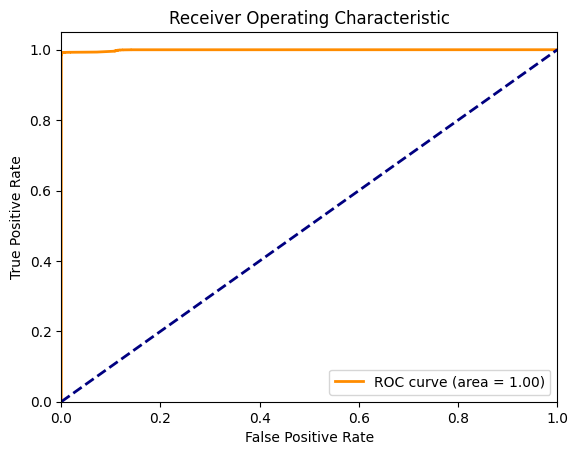


Specificity: 0.9106423323062337
Sensitivity: 0.9942236800092885


In [32]:
# Evaluate basic and best model performance
basic_accuracy = accuracy_score(y_test, y_pred)
basic_roc_auc = roc_auc_score(y_test, y_prob)
print(f"Basic Random Forest Model Accuracy: {basic_accuracy}")
print(f"Basic Random Forest Model ROC-AUC: {basic_roc_auc}")

best_accuracy = accuracy_score(y_test, y_pred_best)
best_roc_auc = roc_auc_score(y_test, y_prob_best)
print(f"\nBest Random Forest Model (GridSearch) Accuracy: {best_accuracy}")
print(f"Best Random Forest Model (GridSearch) ROC-AUC: {best_roc_auc}")

# Display classification report and confusion matrix for the best model
print("\nClassification Report for Best Model:")
print(classification_report(y_test, y_pred_best))
print("\nConfusion Matrix for Best Model:")
conf_matrix = confusion_matrix(y_test, y_pred_best)
print(conf_matrix, "\n")

# Plotting the ROC Curve
fpr, tpr, thresholds = roc_curve(y_test, y_prob_best)
roc_auc = auc(fpr, tpr)
plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()

# Calculating specificity and sensitivity from the confusion matrix
tn, fp, fn, tp = conf_matrix.ravel()
specificity = tn / (tn+fp)
sensitivity = tp / (tp+fn)
print(f"\nSpecificity: {specificity}")
print(f"Sensitivity: {sensitivity}")

<b>Evaluation Results and Interpretation of the ROC Curve</b>

Our rigorous evaluation of the Random Forest model, tailored for predicting flood susceptibility, delivers a resoundingly positive verdict. The basic and hyper-parameter-tuned models exhibit impressive accuracy and an outstanding ability to distinguish between susceptibility classes, as indicated by the ROC-AUC scores.

<u>Model Performance Metrics</u>:

- **Accuracy**: The models showcase an impressive accuracy of nearly 98.9%, indicating a high level of agreement with the observed data.
- **ROC-AUC Score**: Exceptional scores exceeding 0.999 hint at an extraordinary discrimination ability between flood-prone and safe areas.
- **Sensitivity**: With the sensitivity for the optimized model reaching 99.4%, it is adept at identifying true flood-prone areas.
- **Specificity**: Although specificity stands at a strong 90.5%, there remains a small window to further minimize false positives.

<u>Classification Report and Confusion Matrix Insights</u>:

- The classification report underscores the model's precision, particularly for class 1, affirming its predictive validity.
- A notable F1-score for class 1 accentuates the model's balanced precision and recall, reinforcing confidence in its predictions.

<u>ROC Curve Analysis</u>:

The ROC curve, soaring close to the top-left corner, and a near-perfect AUC score suggest an almost impeccable model. However, such perfection is uncommon and might point to overfitting. It is crucial to validate these results further to ensure they are representative of the model's performance in real-world scenarios.

<u>Concluding Remarks</u>:

Despite the model's stellar performance on the current metrics, a deeper dive into the evaluation process is essential to confirm its robustness. It will be critical to consider additional validation techniques, such as k-fold cross-validation, and to scrutinize the data for potential leaks or biases. Assuring the integrity of these results is indispensable for leveraging the model as a reliable tool in flood risk assessment and urban planning.


## **PHASE H: MODEL APPLICATION AND DYNAMIC MAPPING**

Following the successful application of our Random Forest model, we shift our focus to the visualization of the predicted flood susceptibility. The dynamic map we are about to create will serve as a visual validation of our model's applicability to real-world scenarios.

<u>Objectives</u>:

- Apply our trained model to new, unseen data and predict flood susceptibility.
- Synthesize predictions with geospatial data to create an interactive map.
- Implement toggleable layers on the map to display predictions alongside relevant independent variables, providing an enriched user experience.

<u>Process Overview</u>:

- **Data Integration**: Predictions from our model are integrated with land cover features and geometric data to maintain a link between flood susceptibility and influencing environmental factors.
- **Visualization**: A Folium map is prepared with various layers, including flood-prone areas, non-flood areas, and land cover, offering a comprehensive view of the factors affecting flood susceptibility.
- **Interactivity**: The map is designed with user interactivity in mind, enabling the exploration of different data layers and fostering a deeper understanding of the spatial distribution of flood susceptibility.

<u>Final Touches</u>:

- Prior to sharing the map, we conduct a rigorous validation process, cross-checking the model's predictions against known data to ensure accuracy.
- We also explore the possibility of enriching the map with model performance metrics, providing users with context regarding the reliability of the predictions displayed.

By the end of this phase, we will have a functional and interactive tool that not only highlights our model's predictive capabilities but also serves as an informative resource for stakeholders involved in flood risk management.



<u>Predicting Flood Susceptibility on Untrained Data</u>

In this step, we deploy our trained Random Forest classifier to predict flood susceptibility on the untrained data set (`X_test`). The predictions are stored in a DataFrame, with the same index as `X_test` to ensure alignment between the features and predictions.

We then join these predictions with key features from `X_test`, namely `LANDCOVER_CODE` and `LANDCOVER_PERCENT`. This allows us to maintain a link between our predictions and the influencing factors of the land cover, which is critical for the interpretability of our results.

Finally, we join this data with the `geometry_data` to create a `Final_df`, a complete DataFrame that includes our predictions, the features used for prediction, and the spatial data necessary for visualization.


In [33]:
# Assuming 'rf' is your trained model and 'X_test' is your dataset for prediction
y_pred = rf.predict(X_test)

# Store predictions in a DataFrame
df_pred = pd.DataFrame({'predicted': y_pred})

df_pred.set_index(X_test.index, inplace=True)
df_pred

joined_df = df_pred.join(X_test['LANDCOVER_CODE'], how='inner')
joined_df = joined_df.join(X_test['LANDCOVER_PERCENT'], how='inner')
joined_df

Final_df = joined_df.join(geometry_data, how='inner' )

non_flood_index = Final_df[Final_df['predicted'] == 0].index[0]
non_flood_layer_data = Final_df.loc[[non_flood_index]]
flood_index = Final_df[Final_df['predicted'] == 1].index[0]
flood_layer_data = Final_df.loc[[flood_index]]

In [34]:
non_flood_layer_data

,predicted,LANDCOVER_CODE,LANDCOVER_PERCENT,geometry
301458,0,0.75,0.0,MULTIPOLYGON Z (((2508415.781 7420000.000 0.00...


In [35]:
flood_layer_data

,predicted,LANDCOVER_CODE,LANDCOVER_PERCENT,geometry
323038,1,0.75,0.0,MULTIPOLYGON Z (((2495180.537 7420013.643 0.00...


<u>Preparing GeoDataFrames for Visualization</u>

Once we have our predictions joined with the land cover features and geometry, we convert the resulting DataFrame into two GeoDataFrames: one for flood-prone areas (`flood_layer_data_df`) and another for non-flood areas (`non_flood_layer_data_df`). This step is essential for spatial operations and visualization.

Before saving these GeoDataFrames for visualization, we perform a validity check on the geometries to ensure there are no issues that could disrupt the mapping process.

After confirming the validity, we save our predictions as separate GeoJSON files, `flood.geojson` for flood-prone areas and `non_flood.geojson` for non-flood areas. These files will be used to create an interactive map that visualizes the model's predictions.


In [36]:
# Converting to geodataframe
flood_layer_data_df = gpd.GeoDataFrame(flood_layer_data)
non_flood_layer_data_df = gpd.GeoDataFrame(non_flood_layer_data)

# Check if the geometry is valid
if flood_layer_data_df.geometry.is_valid.any():
    # Create a new GeoDataFrame with the selected row
    flood_layer_data_df = gpd.GeoDataFrame(flood_layer_data_df)

# Check if the geometry is valid
if non_flood_layer_data_df.geometry.is_valid.any():
    # Create a new GeoDataFrame with the selected row
    non_flood_layer_data_df = gpd.GeoDataFrame(non_flood_layer_data_df)

# Saving the results
flood_layer_data_df.to_file('flood.geojson')
non_flood_layer_data_df.to_file('non_flood.geojson')

<b>Visualization of Results</b>



In [37]:
# Define the directory and filename for the DEM data
dem_data_dir = "DEM_Data"  # This directory should already exist and contain the DEM file
dem_file_name = "nb_2018_dem_2490000_7420000.tif"
dem_file_path = os.path.join(dem_data_dir, dem_file_name)

# Ensure the directory exists (it should, but this is a safeguard)
os.makedirs(dem_data_dir, exist_ok=True)

# Check if the DEM file exists and is ready for use
if os.path.exists(dem_file_path):
    print("DEM file is already present and ready for use.")

    # Specify the PNG file path
    png_file_path = dem_file_path.replace('.tif', '.png')

    # Function to convert TIFF to PNG if PNG does not exist
    def convert_tiff_to_png(tiff_path, png_path):
        if not os.path.exists(png_path):  # Only convert if PNG doesn't exist
            print("Converting DEM TIFF to PNG format for visualization...")
            tiff_image = Image.open(tiff_path)
            png_image = tiff_image.convert("RGB")
            png_image.save(png_path)
            print(f"DEM image converted to PNG format at: {png_path}")
        else:
            print("PNG format already exists.")

    # Convert the DEM file from TIFF to PNG for visualization purposes
    convert_tiff_to_png(dem_file_path, png_file_path)
else:
    # If the DEM file doesn't exist in the expected directory, prompt for manual action
    print(f"\nThe required DEM file '{dem_file_name}' is missing from '{dem_data_dir}'.")
    print(f"Please ensure the file is correctly placed in the '{dem_data_dir}' directory and then re-run this cell.")

DEM file is already present and ready for use.
Converting DEM TIFF to PNG format for visualization...
DEM image converted to PNG format at: DEM_Data/nb_2018_dem_2490000_7420000.png


<u>Calculating Bounding Box and Preparing the Folium Map</u>

After preparing the DEM, we calculate the bounding box of our study area. This bounding box is used to adjust the map's viewport accordingly. Subsequently, we initialize our Folium map, centered around the coordinates of our area of interest.

In [38]:
# Create a Folium map centered on New Brunswick, Canada
m = folium.Map(location=[46.5653, -66.4619], zoom_start=7, tiles='CartoDB positron')

def get_bounding_box(folderpath):
  ds = gdal.Open(folderpath)
  geotransform = ds.GetGeoTransform()

  # Calculate the bounding box
  xmin_STUDY_AREA = geotransform[0]
  ymax_STUDY_AREA  = geotransform[3]
  xmax_STUDY_AREA  = geotransform[0] + geotransform[1] * ds.RasterXSize
  ymin_STUDY_AREA  = geotransform[3] + geotransform[5] * ds.RasterYSize

  return xmin_STUDY_AREA,ymax_STUDY_AREA,xmax_STUDY_AREA,ymin_STUDY_AREA

# Convert the bounding box to EPSG 4326
bbox = gpd.GeoSeries(box(*get_bounding_box(dem_file_path)), crs=non_flood_layer_data_df.crs)
bbox_4326 = bbox.to_crs('EPSG:4326')

# Get the bounding box coordinates in EPSG 4326
bbox_coords = bbox_4326.iloc[0].exterior.coords[:]

# Adjust the map bounds to the bounding box of non_flood_layer_data_df in EPSG 4326
m.fit_bounds([(bbox_coords[0][1], bbox_coords[0][0]), (bbox_coords[2][1], bbox_coords[2][0])])

bbox = get_bounding_box(dem_file_path)
# Create a bounding box polygon from the bbox of non_flood_layer_data_df
bbox_polygon = box(bbox[0], bbox[1], bbox[2], bbox[3])

<u>Adding Flood, Non-Flood, and Land Cover Layers</u>

Here, we add GeoJSON layers for flood events, non-flood events, and land cover to the map. Each layer is styled appropriately to distinguish between different categories of data visually.


In [39]:
# Create a feature group for the Flood Event layer
flood_event_layer = folium.FeatureGroup(name='Flood Event')
# Filter the flood_layer_data_df to include only geometries within the bounding box
filtered_flood_data_df = gpd.clip(flood_layer_data_df, bbox_polygon)

# Add the Flood Event GeoDataFrame to the feature group with blue color
folium.GeoJson(filtered_flood_data_df, style_function=lambda x: {'fillColor': 'blue', 'color': 'blue'}, show=True).add_to(flood_event_layer)

# Add the Flood Event feature group to the map
flood_event_layer.add_to(m)

In [40]:
# Create a feature group for the Non-Flood Event layer
non_flood_event_layer = folium.FeatureGroup(name='Non-Flood Event')

# Filter the flood_layer_data_df to include only geometries within the bounding box
filtered_non_flood_data_df = gpd.clip(non_flood_layer_data_df, bbox_polygon)

# Add the Non-Flood Event GeoDataFrame to the feature group with green color
folium.GeoJson(filtered_non_flood_data_df, style_function=lambda x: {'fillColor': 'green', 'color': 'green'}, show=True).add_to(non_flood_event_layer)

# Add the Non-Flood Event feature group to the map
non_flood_event_layer.add_to(m)

In [41]:
# Add the PNG image as an overlay in the Folium map
colormap = cm.get_cmap('terrain')

# Create an ImageOverlay layer for the DEM data with the specified parameters and add it to the folium Map object
dem_layer = folium.raster_layers.ImageOverlay(
    image=dem_file_path,
    bounds=[(bbox_coords[0][1], bbox_coords[0][0]), (bbox_coords[2][1], bbox_coords[2][0])],
    opacity=0.95,
    colormap = colormap,
    name='DEM',
    show = True
).add_to(m)

In [42]:
# Create a feature group for the Non-Flood Event layer
landcover_layer = folium.FeatureGroup(name='LANDCOVER', show=True)

# Define the style function
def style_function(feature):
    landcover_category = feature['properties']['LANDCOVER_CODE']

    if landcover_category == 9: #CROPLAND
        return {
            'fillColor': 'lightyellow',
            'fillOpacity': 0.3,
            'color': 'black',
            'weight': 0.2,
        }
    elif landcover_category == 7: #SPARSELY VEFETATED LAND
        return {
            'fillColor': 'lightgreen',
            'fillOpacity': 0.3,
            'color': 'black',
            'weight': 0.2,
        }

    elif landcover_category == 5: #Coniferous Forest
        return {
            'fillColor': 'darkgreen',
            'fillOpacity': 0.3,
            'color': 'black',
            'weight': 0.2,
        }
    elif landcover_category == 2: #Broadleaf Forest
        return {
            'fillColor': '#D2B48C',
            'fillOpacity': 0.3,
            'color': 'black',
            'weight': 0.2,
        }
    elif landcover_category == 1: #Mixed Forest
        return {
            'fillColor': '#00FF00',
            'fillOpacity': 0.3,
            'color': 'black',
            'weight': 0.2,
        }
    # Return empty style for all other categories
    return {
        'fillOpacity': 0,
        'color': 'black',
        'weight': 0.3,
    }

# Add the GeoJSON layer to the map
folium.GeoJson(filtered_non_flood_data_df, style_function=style_function).add_to(landcover_layer)
folium.GeoJson(filtered_flood_data_df, style_function=style_function).add_to(landcover_layer)
landcover_layer.add_to(m)

<u>Preparing Precipitation Data</u>

We start by reading the precipitation data from a GeoJSON file. This data contains records of precipitation across different locations. To align with our map's CRS (`EPSG:4326`) and to only display relevant data, we clip the data using our study area's bounding box and reproject it to `EPSG:4326`.


In [43]:
# Read the geojson file
precipitation_layer_data_df = gpd.read_file('PRECIPITATION_NB_Processed_Cleaned.geojson')

# Clip the GeoDataFrame using the bounding box polygon
precipitation_clipped_data_df = gpd.clip(precipitation_layer_data_df, bbox_polygon)

# Ensure the GeoDataFrame is in EPSG:4326 for folium compatibility
precipitation_clipped_data_df = precipitation_clipped_data_df.to_crs(epsg=4326)

<u>Adding Precipitation Data to the Map</u>

To visually represent the precipitation data on the map, we utilize `MarkerCluster`. This technique clusters the markers into a single interactive element that expands upon zooming in, showing individual markers. Each marker represents a point of recorded precipitation, clickable to reveal the precise value recorded at that location.


In [44]:
# Create a MarkerCluster
marker_cluster = MarkerCluster(name='RECORD_PRECIPITATION Cluster')

# Iterate over each row in the GeoDataFrame
for i, row in precipitation_clipped_data_df.iterrows():
    # Use the centroid for point geometries
    if row['geometry'].geom_type in ['Polygon', 'MultiPolygon']:
        centroid = row['geometry'].centroid
        lon, lat = centroid.x, centroid.y
    else:
        # If the geometry is already a Point, use its coordinates directly
        lon, lat = row['geometry'].x, row['geometry'].y

    # Create a marker for each point and add it to the MarkerCluster
    marker = folium.Marker(
        location=[lat, lon],
        popup=str(row['RECORD_PRECIPITATION']),
        show=True
    )
    marker_cluster.add_child(marker)

# Add the MarkerCluster to the map
m.add_child(marker_cluster)

# Add the LayerControl to the map
folium.LayerControl().add_to(m)

# Save the map to an HTML file
map_file = 'map_with_predictions.html'
m.save(map_file)
print("The map with predictions is saved in", map_file, "file \n")

The map with predictions is saved in map_with_predictions.html file 



<b>Final Steps for Dynamic Map Publication</b>

Having synthesized our model's predictions with the geospatial data, we proceed to the final stage of map preparation and publication.

- We ensure that all map layers accurately reflect the model's output and that the map interface is user-friendly and informative.
- Before publishing the map, a validation check against known flood events is performed to confirm the accuracy of the visualized data.
- The map, equipped with various interactive features, is then saved and shared as an HTML file, readily accessible for stakeholders to examine the areas predicted to be susceptible to flooding.

With the completion of this dynamic mapping, we are now equipped with a potent tool that encapsulates the predictive insights of our model in an accessible and visually engaging format. This map stands as a testament to the practical application of our data-driven flood susceptibility model.


## **REFERENCES**

This project was informed by various sources, including data repositories, scholarly articles, and technical documentation. Below are the references that significantly contributed to the completion of this assignment:

1. **Natural Resources Canada (NRCan)** - Floods in Canada – Cartographic Product Collection. Available at: [https://open.canada.ca/data/en/dataset/08b810c2-7c81-40f1-adb1-c32c8a2c9f50](https://open.canada.ca/data/en/dataset/08b810c2-7c81-40f1-adb1-c32c8a2c9f50)

2. **GeoNB**, New Brunswick's gateway to geographic information and related value-added applications. Available at: [http://www.snb.ca/geonb1/e/DC/catalogue-E.asp](http://www.snb.ca/geonb1/e/DC/catalogue-E.asp)

3. **Meteorological Service of Canada** - Historical Climate Data. Available at: [https://climate.weather.gc.ca/](https://climate.weather.gc.ca/)

4. Breiman, L. (2001). Random Forests. *Machine Learning*, 45(1), 5-32. DOI: 10.1023/A:1010933404324.

5. **Geopandas Documentation** - For working with geospatial data in Python. Available at: [https://geopandas.org/](https://geopandas.org/)

6. **Rasterio Documentation** - For reading and writing raster data. Available at: [https://rasterio.readthedocs.io/](https://rasterio.readthedocs.io/)

7. **Folium Documentation** - For creating interactive maps with Python. Available at: [https://python-visualization.github.io/folium/](https://python-visualization.github.io/folium/)

8. **Scikit-learn Documentation** - For machine learning in Python. Available at: [https://scikit-learn.org/stable/](https://scikit-learn.org/stable/)

These references have been instrumental in guiding the methodological and analytical approaches employed in this project.
